model loaded!!!
1/1 [==============================] - 0s 409ms/step


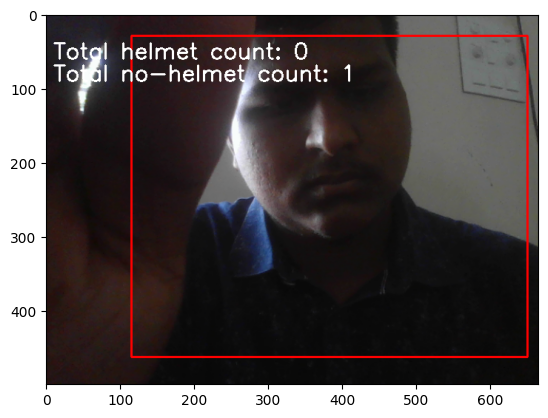

1/1 [==============================] - 0s 67ms/step


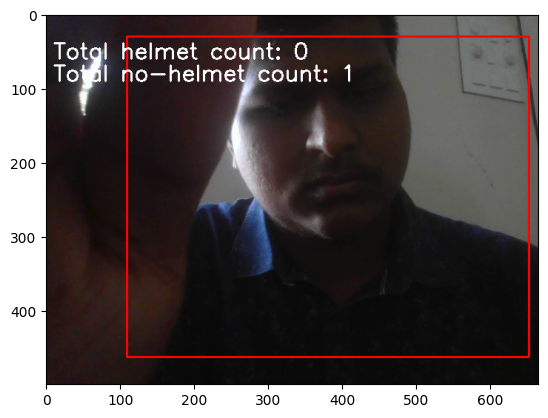

1/1 [==============================] - 0s 59ms/step


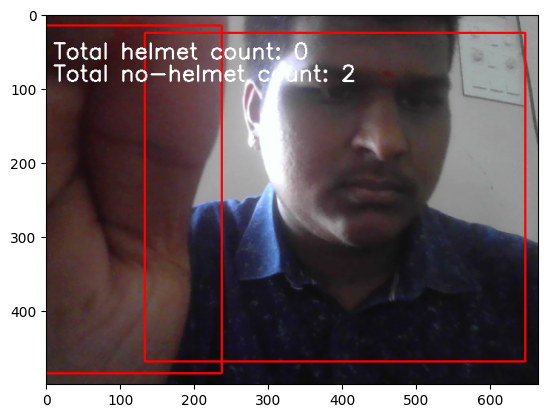

1/1 [==============================] - 0s 115ms/step


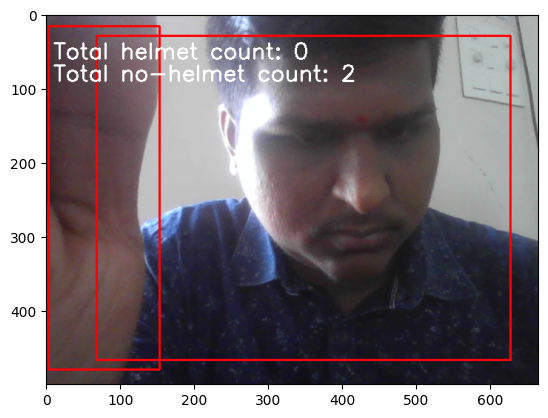

1/1 [==============================] - 0s 115ms/step


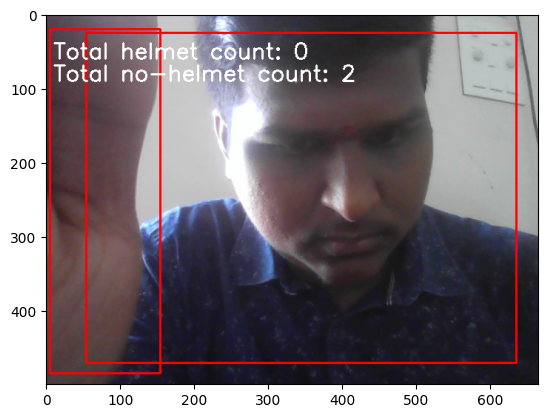

1/1 [==============================] - 0s 128ms/step


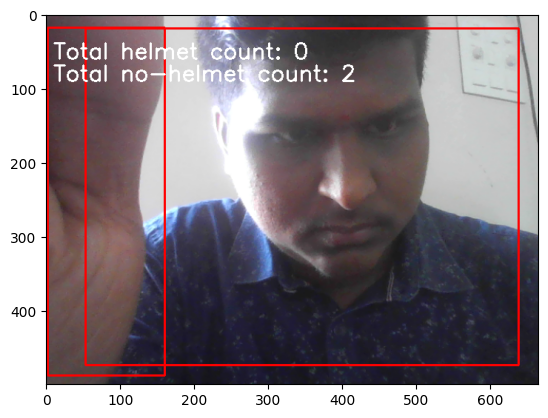

1/1 [==============================] - 0s 107ms/step


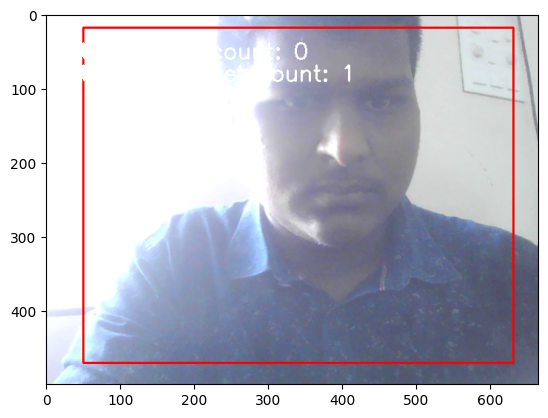

1/1 [==============================] - 0s 110ms/step


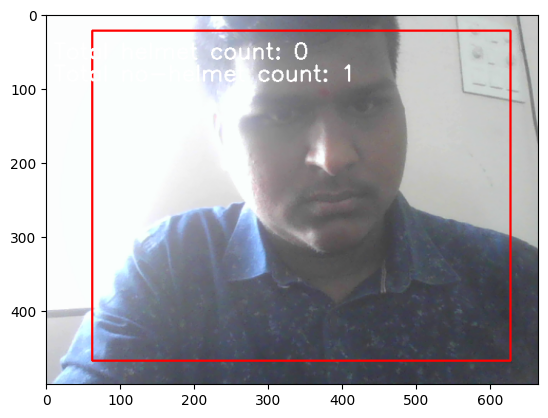

1/1 [==============================] - 0s 114ms/step


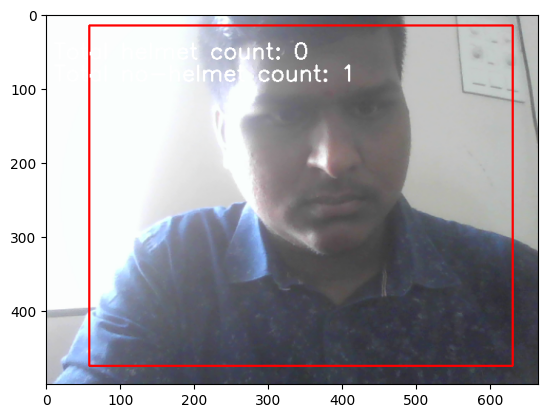

1/1 [==============================] - 0s 107ms/step


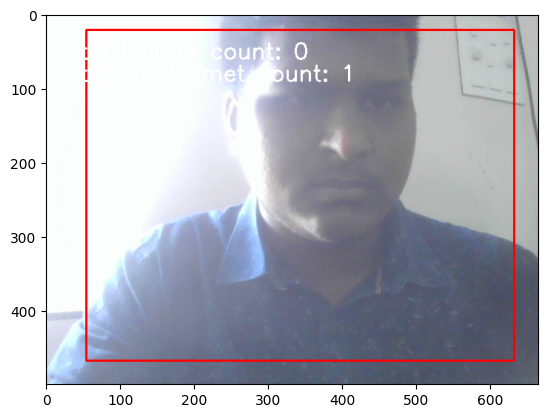

1/1 [==============================] - 0s 134ms/step


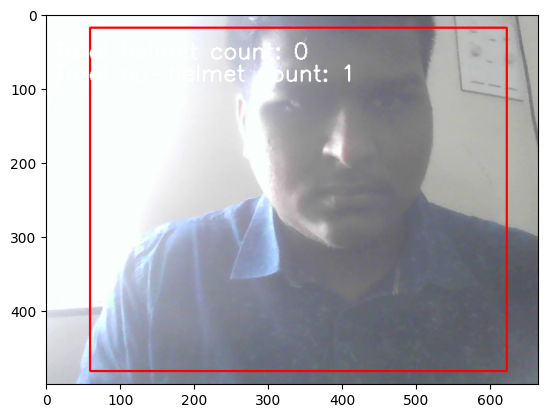

1/1 [==============================] - 0s 120ms/step


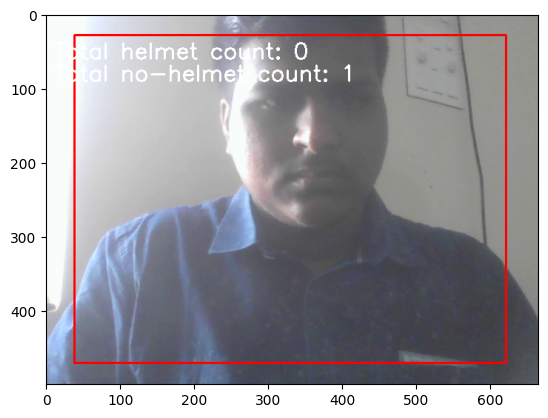

1/1 [==============================] - 0s 110ms/step


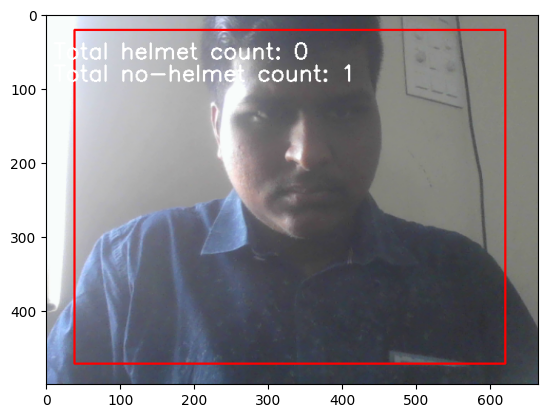

1/1 [==============================] - 0s 145ms/step


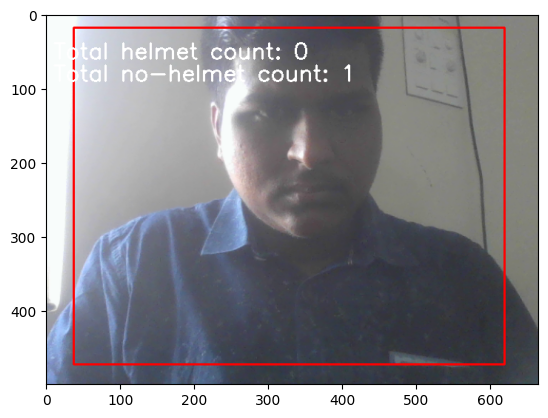

1/1 [==============================] - 0s 120ms/step


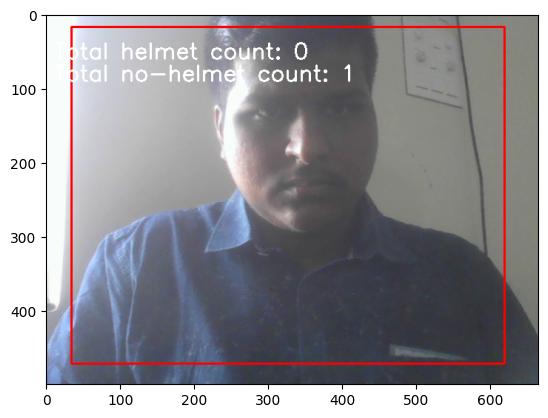

1/1 [==============================] - 0s 111ms/step


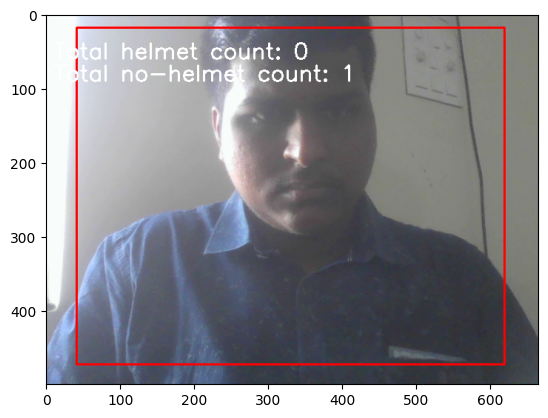

1/1 [==============================] - 0s 134ms/step


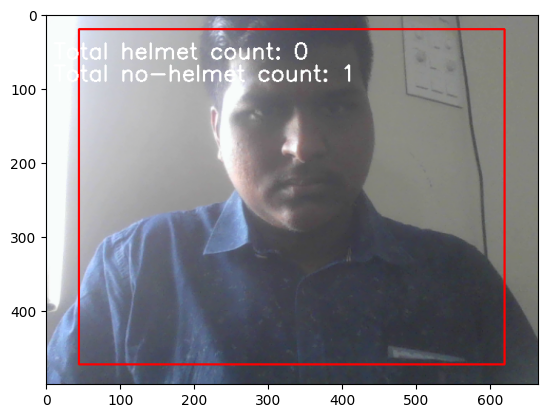

1/1 [==============================] - 0s 115ms/step


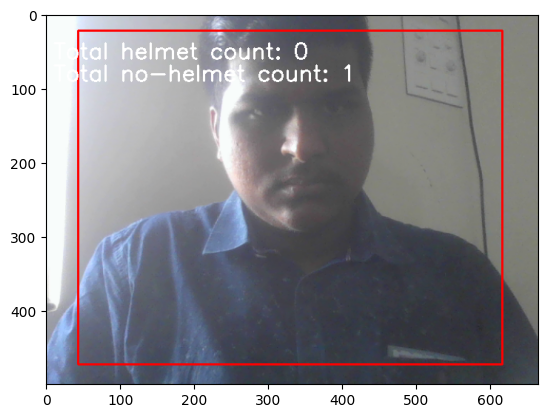

1/1 [==============================] - 0s 114ms/step


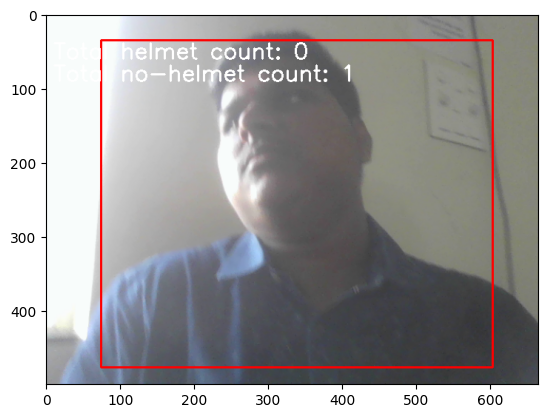

1/1 [==============================] - 0s 115ms/step


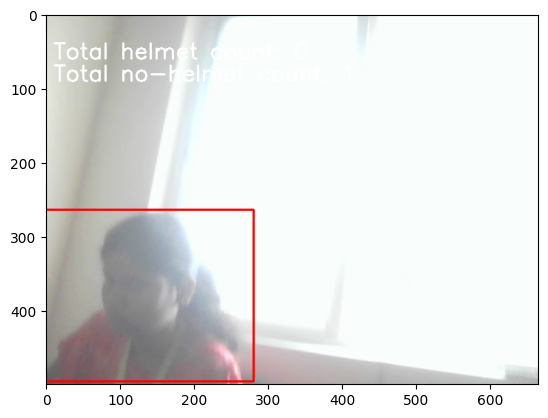

1/1 [==============================] - 0s 111ms/step


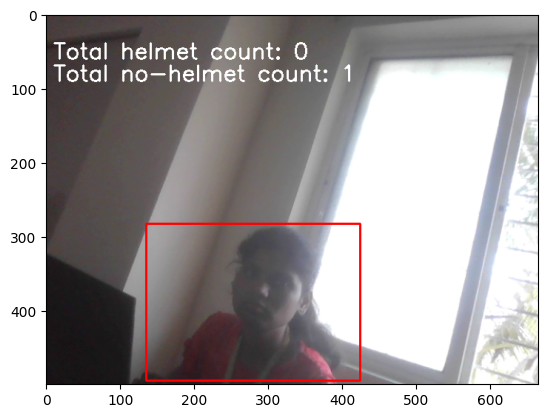

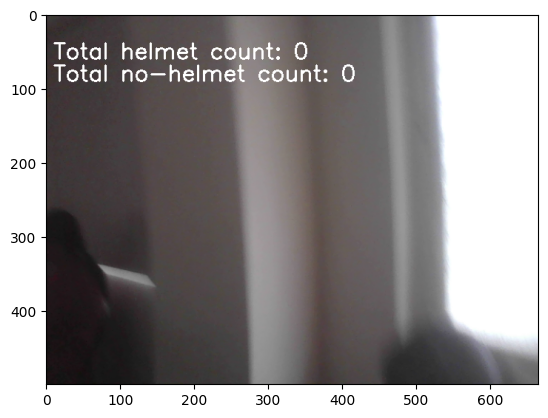

1/1 [==============================] - 0s 125ms/step


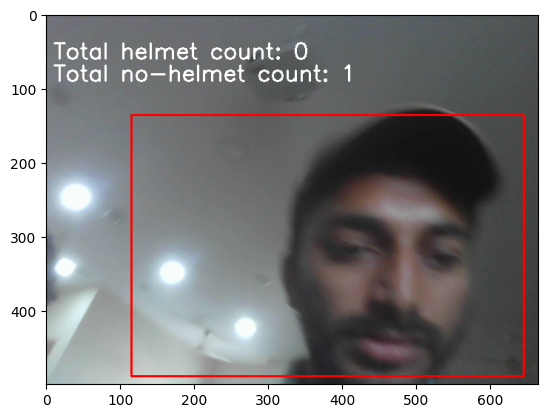

1/1 [==============================] - 0s 120ms/step


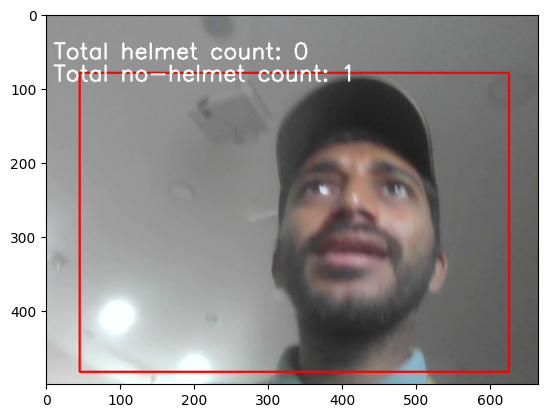

1/1 [==============================] - 0s 125ms/step


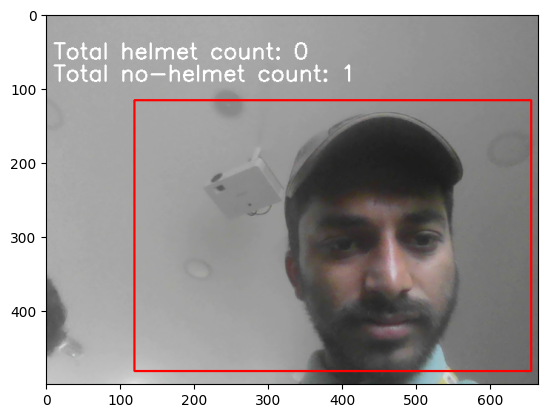

1/1 [==============================] - 0s 128ms/step


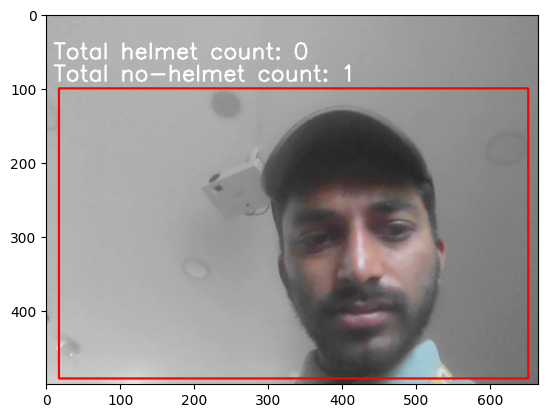

1/1 [==============================] - 0s 136ms/step


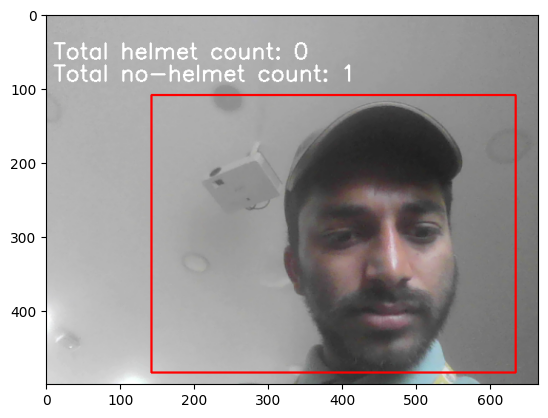

1/1 [==============================] - 0s 119ms/step


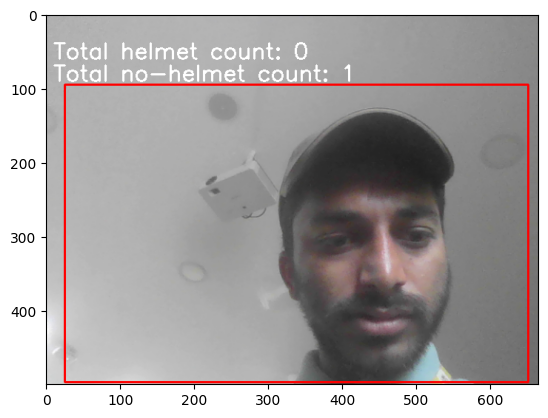

1/1 [==============================] - 0s 112ms/step


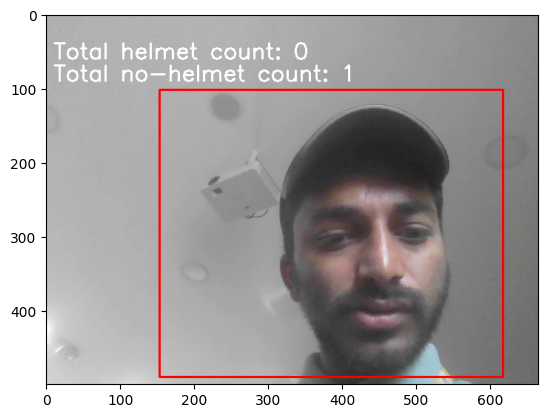

1/1 [==============================] - 0s 135ms/step


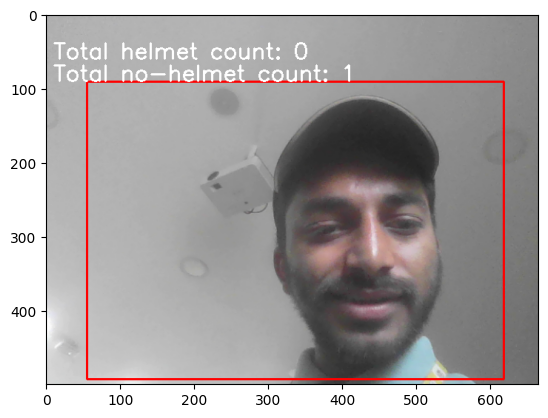

1/1 [==============================] - 0s 118ms/step


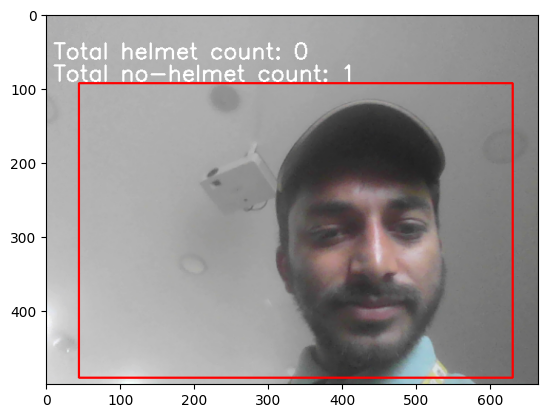

1/1 [==============================] - 0s 109ms/step


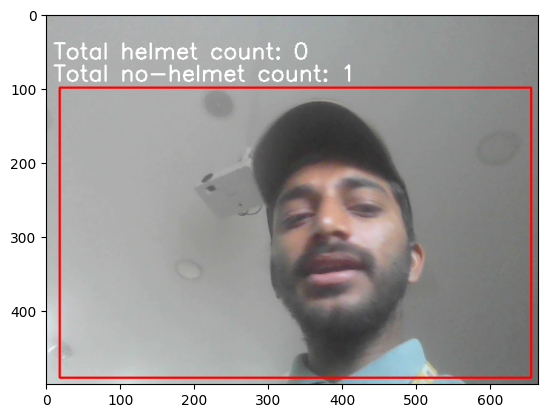

1/1 [==============================] - 0s 119ms/step


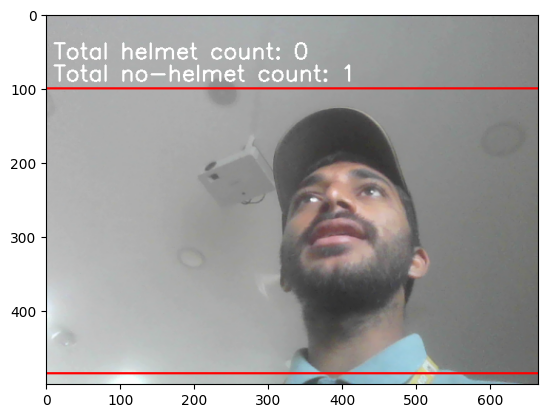

1/1 [==============================] - 0s 111ms/step


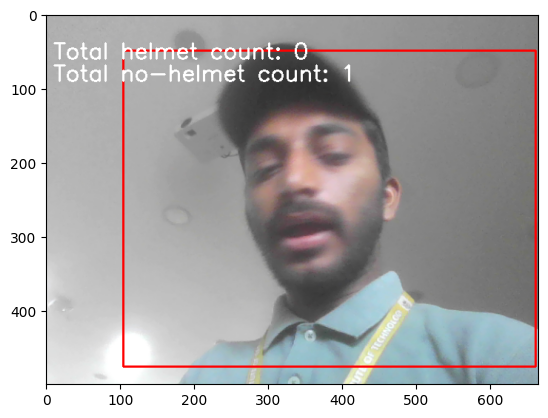

1/1 [==============================] - 0s 130ms/step


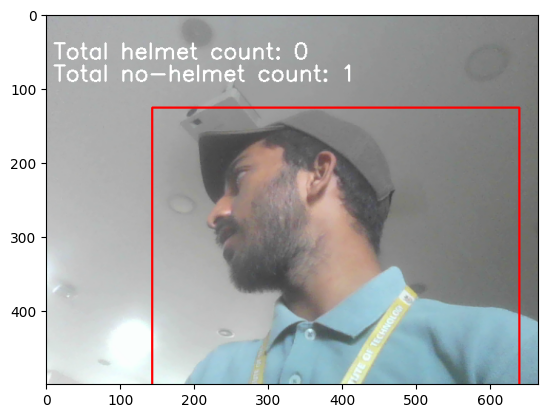

1/1 [==============================] - 0s 112ms/step


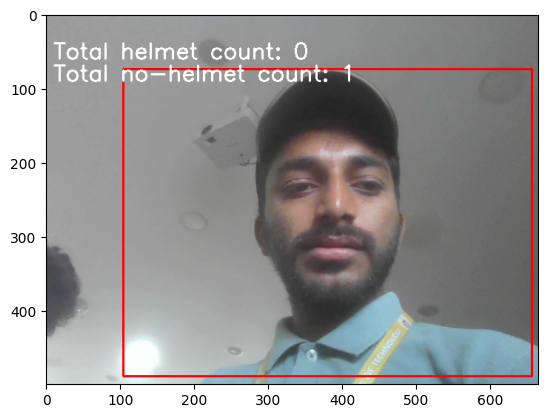

1/1 [==============================] - 0s 113ms/step


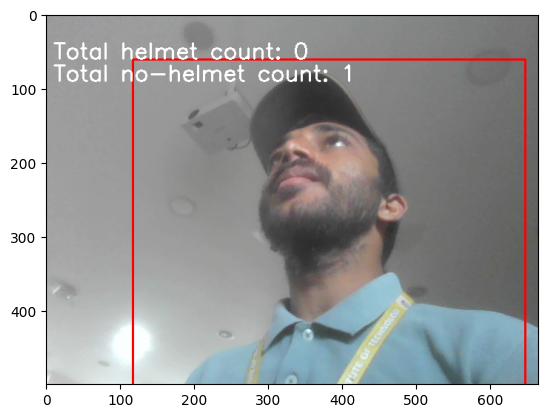

1/1 [==============================] - 0s 131ms/step


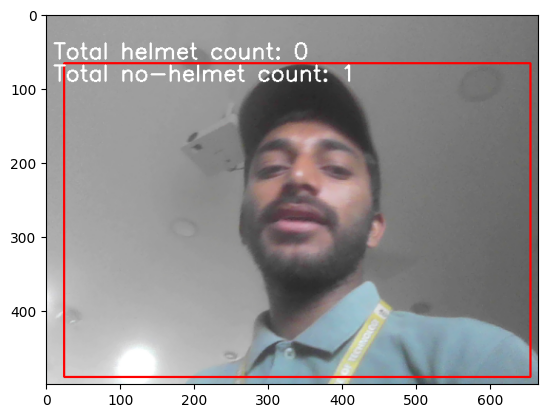

1/1 [==============================] - 0s 121ms/step


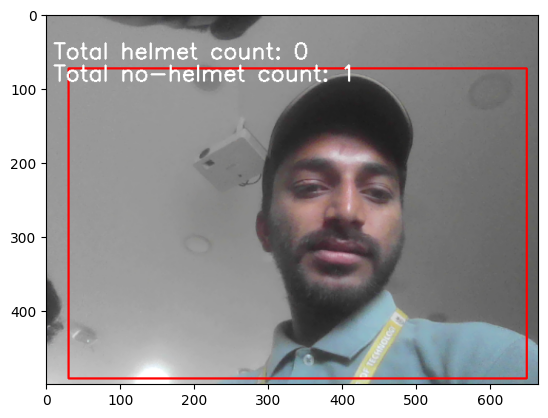

1/1 [==============================] - 0s 118ms/step


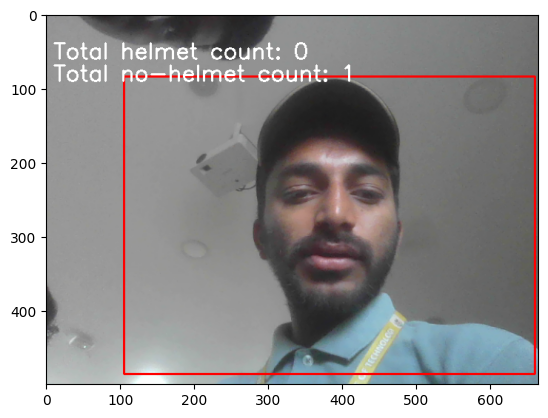

1/1 [==============================] - 0s 114ms/step


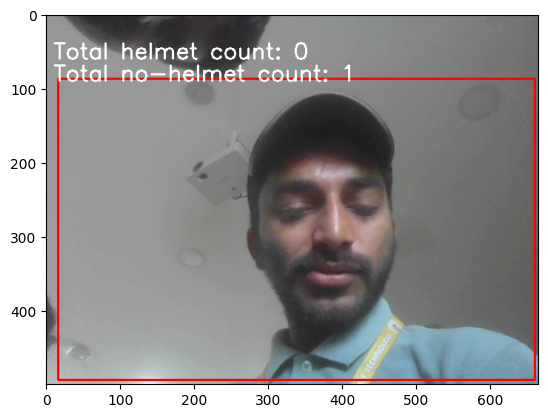

1/1 [==============================] - 0s 109ms/step


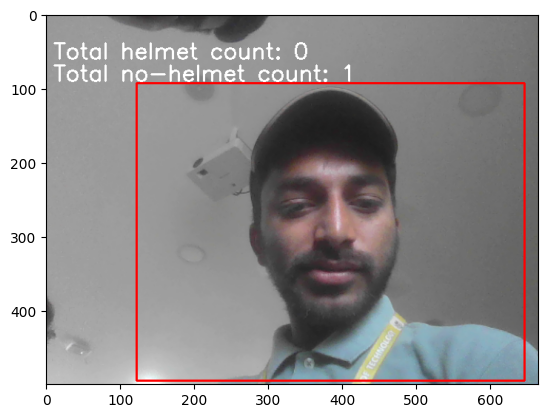

1/1 [==============================] - 0s 119ms/step


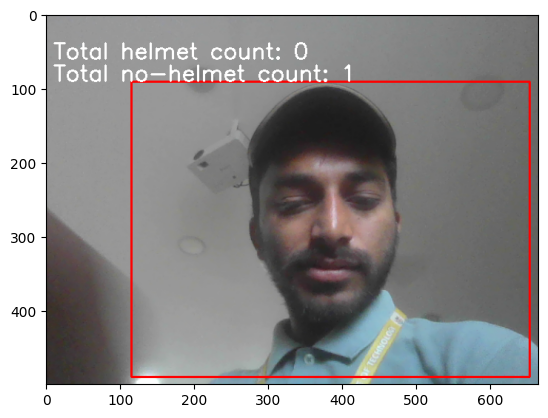

1/1 [==============================] - 0s 118ms/step


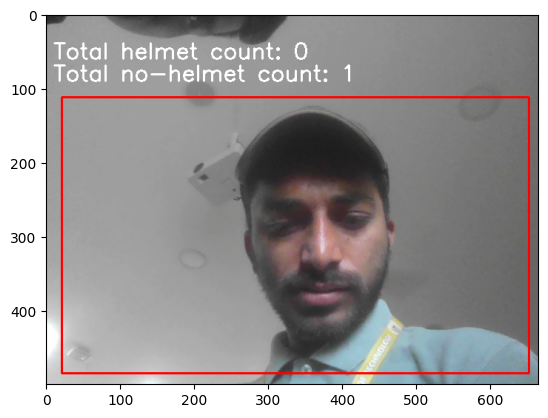

1/1 [==============================] - 0s 115ms/step


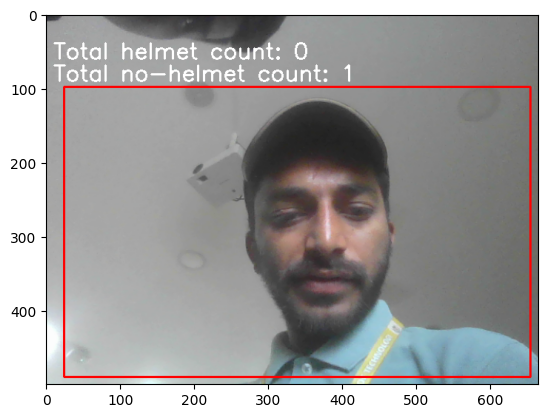

1/1 [==============================] - 0s 139ms/step


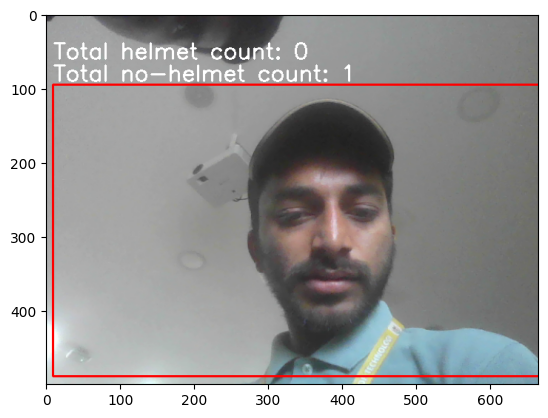

1/1 [==============================] - 0s 130ms/step


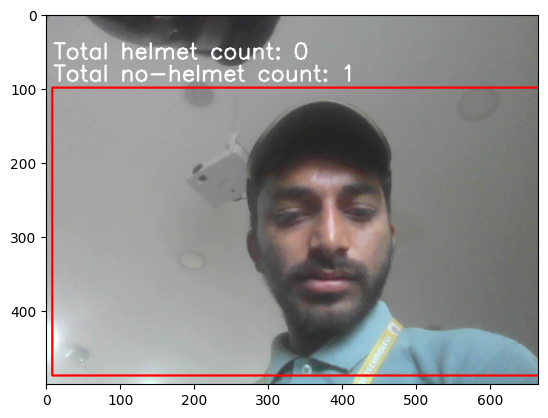

1/1 [==============================] - 0s 116ms/step


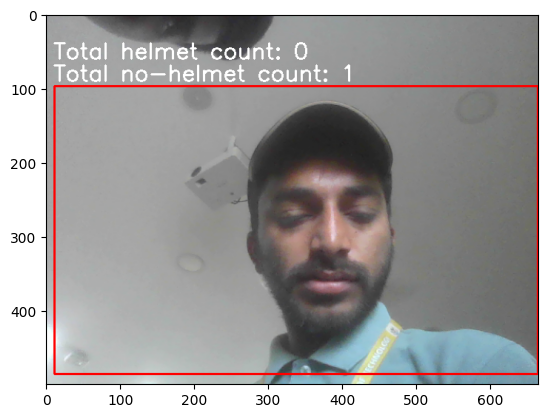

1/1 [==============================] - 0s 110ms/step


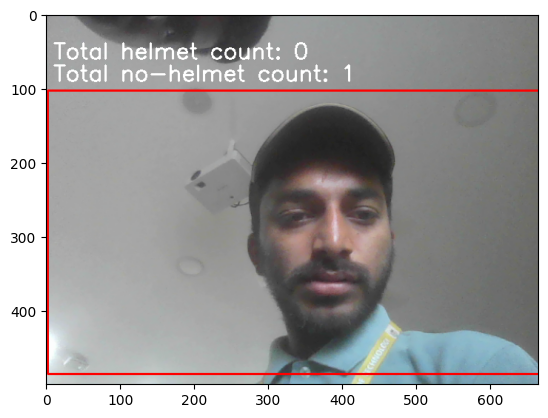

1/1 [==============================] - 0s 118ms/step


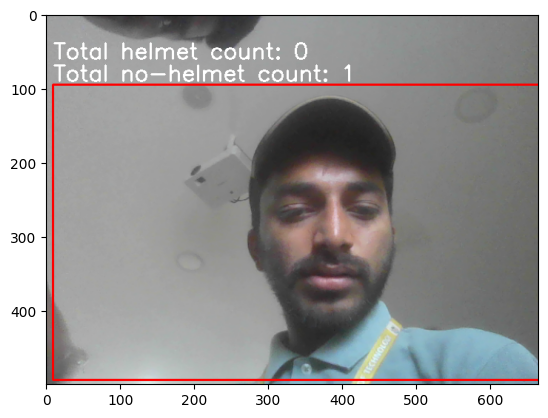

1/1 [==============================] - 0s 124ms/step


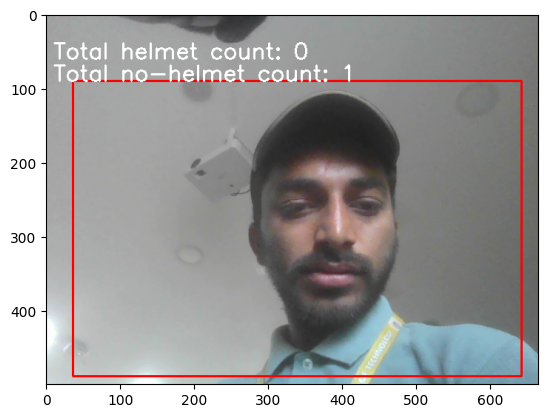

1/1 [==============================] - 0s 110ms/step


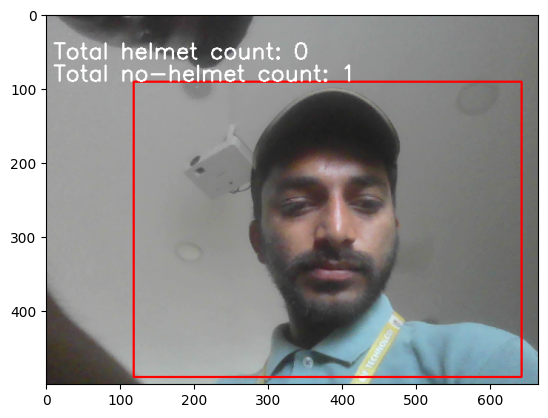

1/1 [==============================] - 0s 115ms/step


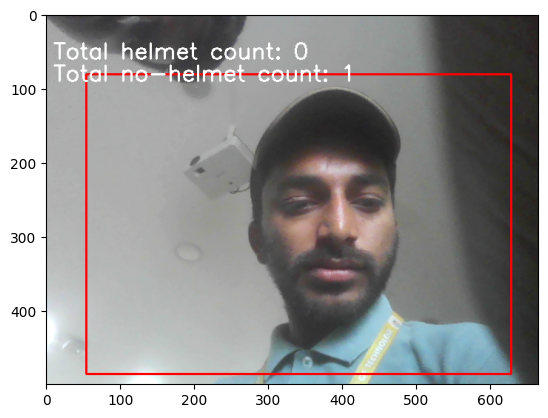

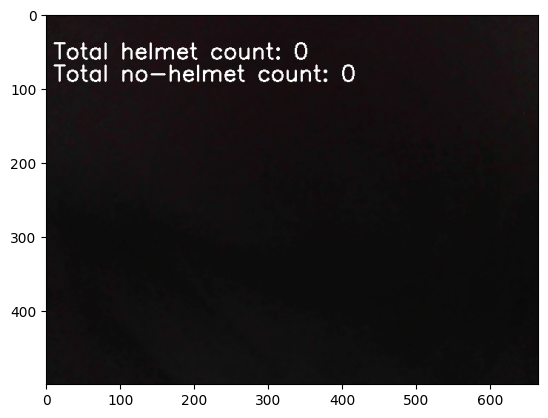

1/1 [==============================] - 0s 119ms/step


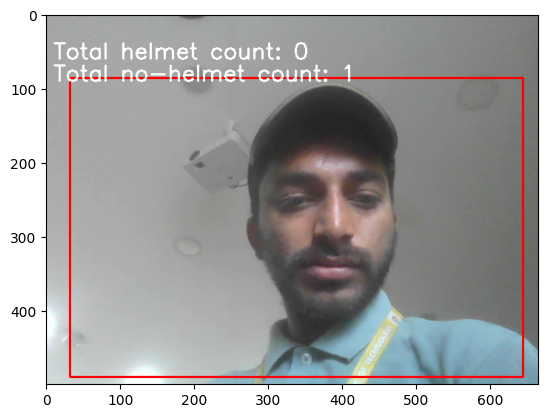

1/1 [==============================] - 0s 131ms/step


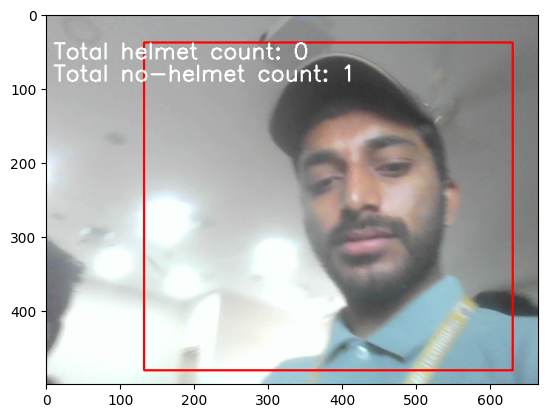

1/1 [==============================] - 0s 135ms/step


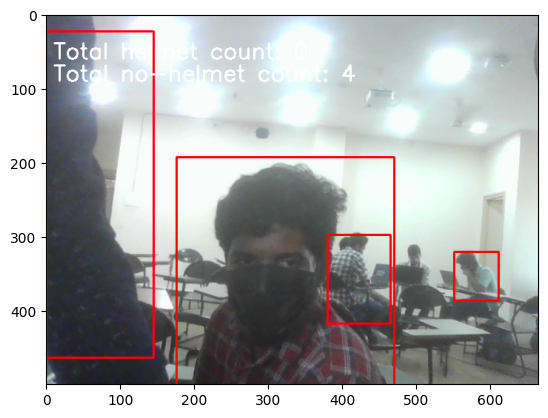

1/1 [==============================] - 0s 134ms/step


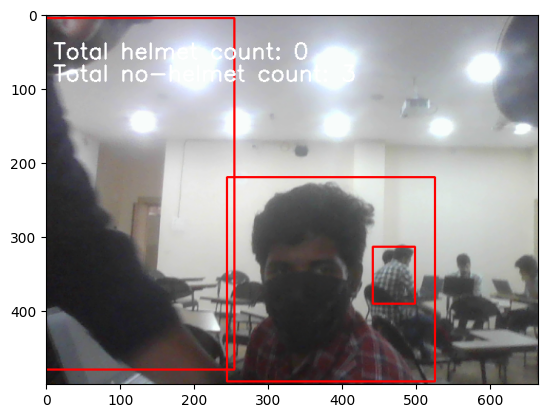

1/1 [==============================] - 0s 126ms/step


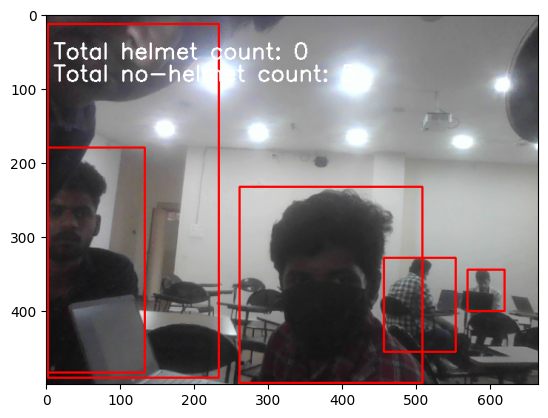

1/1 [==============================] - 0s 109ms/step


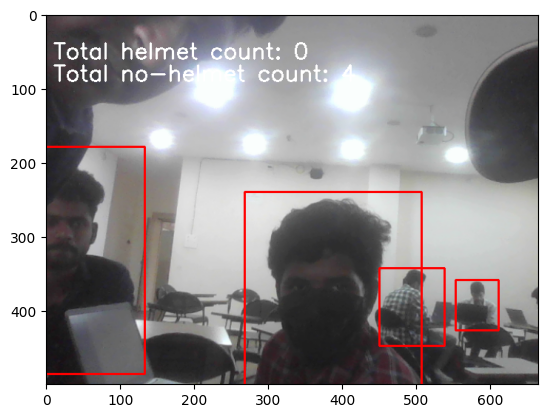

1/1 [==============================] - 0s 126ms/step


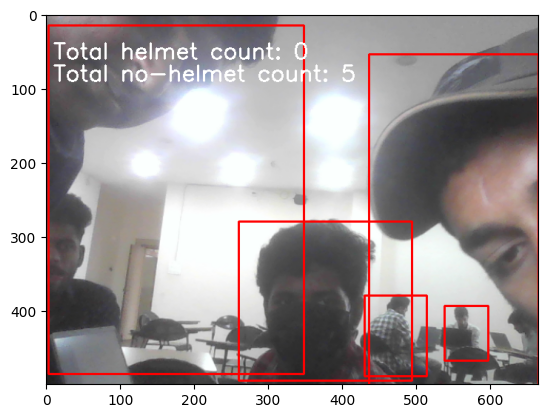

1/1 [==============================] - 0s 117ms/step


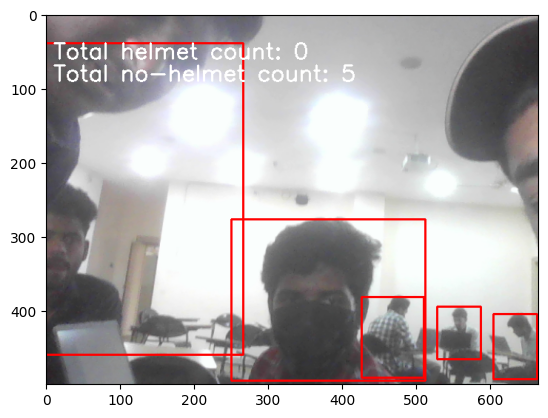

1/1 [==============================] - 0s 116ms/step


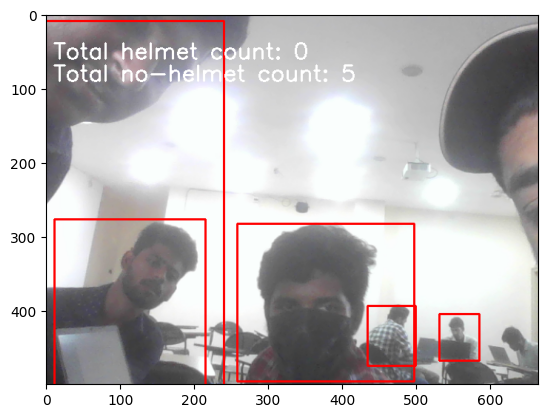

1/1 [==============================] - 0s 107ms/step


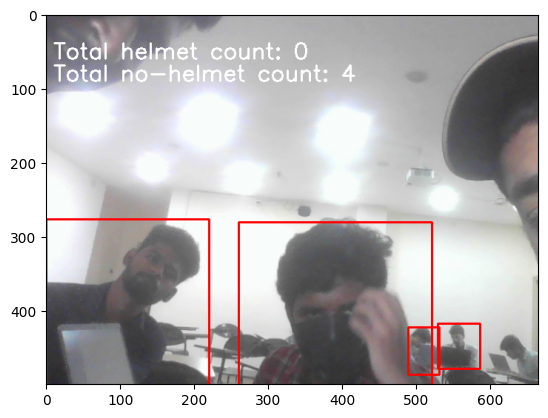

1/1 [==============================] - 0s 113ms/step


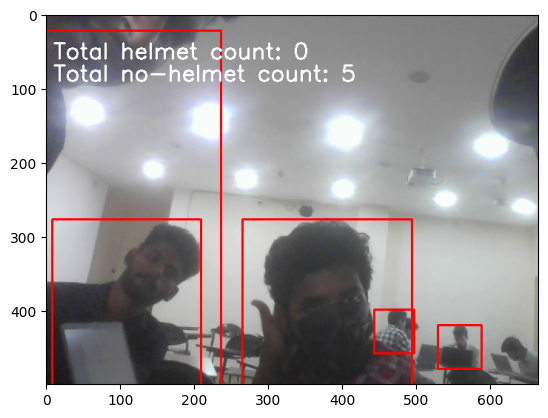

1/1 [==============================] - 0s 118ms/step


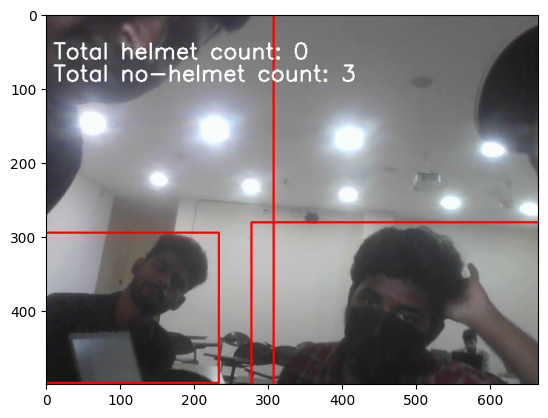

1/1 [==============================] - 0s 119ms/step


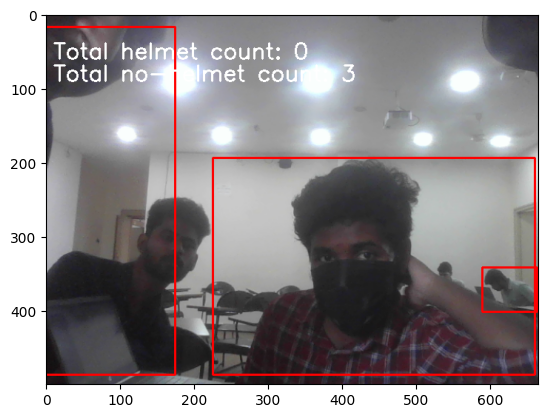

1/1 [==============================] - 0s 123ms/step


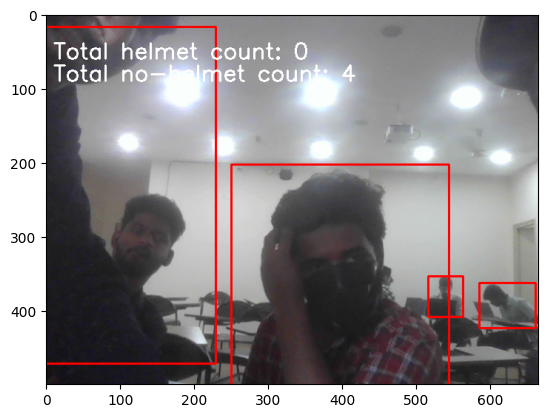

1/1 [==============================] - 0s 108ms/step


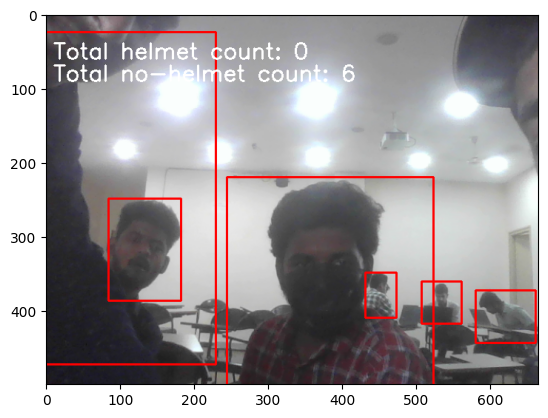

1/1 [==============================] - 0s 107ms/step


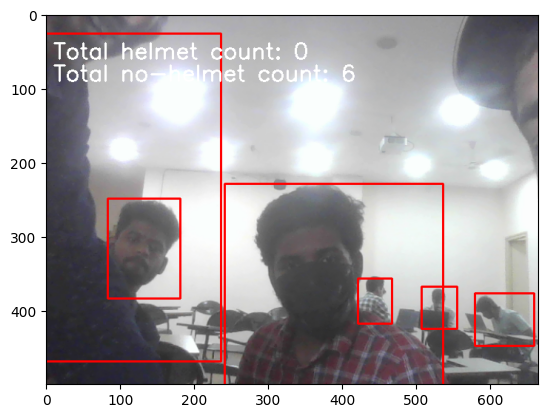

1/1 [==============================] - 0s 112ms/step


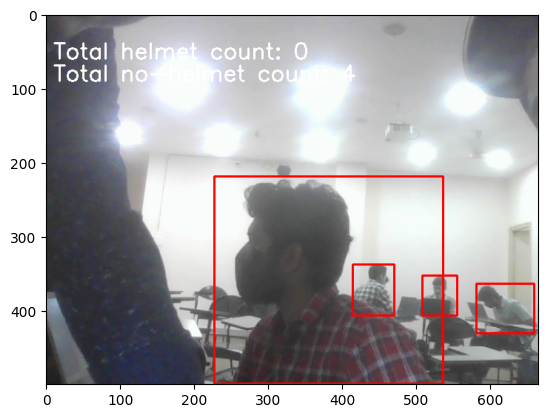

1/1 [==============================] - 0s 125ms/step


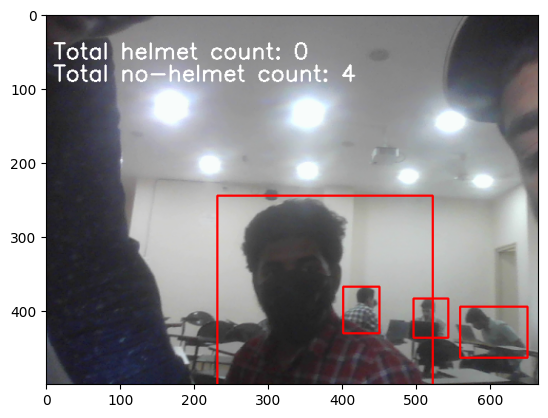

1/1 [==============================] - 0s 108ms/step


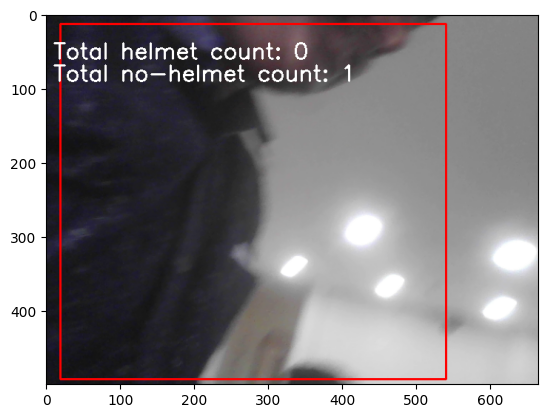

1/1 [==============================] - 0s 111ms/step


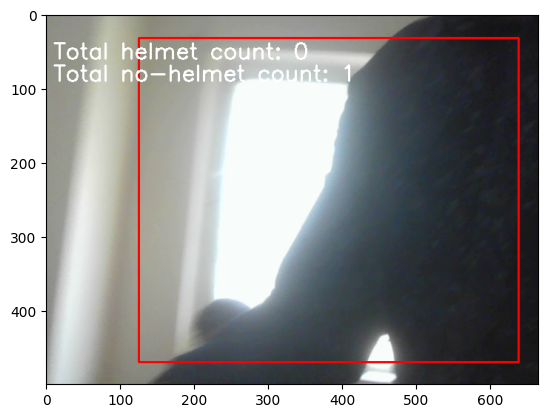

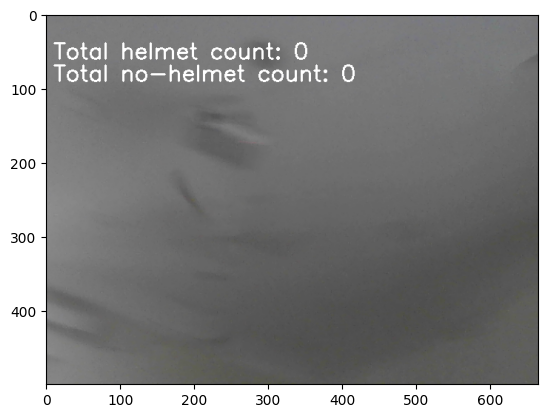

1/1 [==============================] - 0s 110ms/step


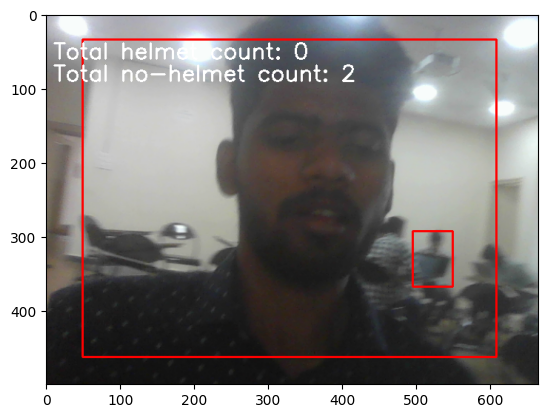

1/1 [==============================] - 0s 121ms/step


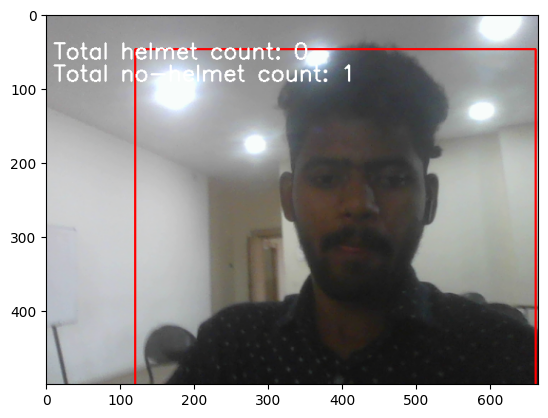

1/1 [==============================] - 0s 131ms/step


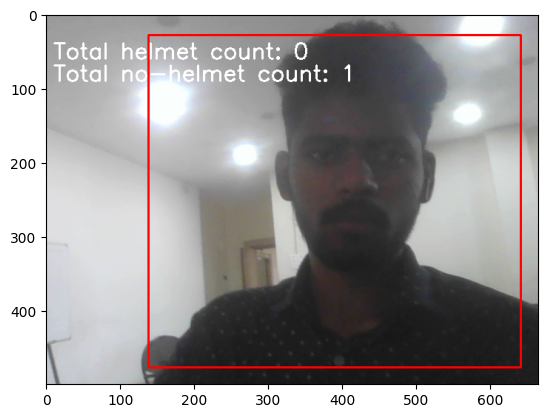

1/1 [==============================] - 0s 124ms/step


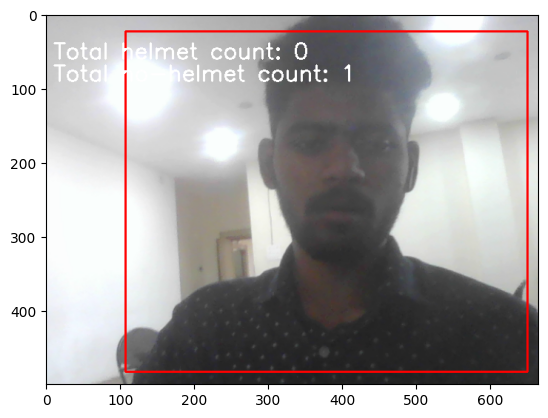

1/1 [==============================] - 0s 120ms/step


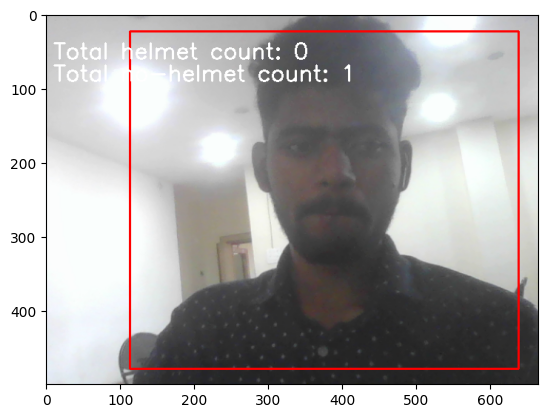

1/1 [==============================] - 0s 115ms/step


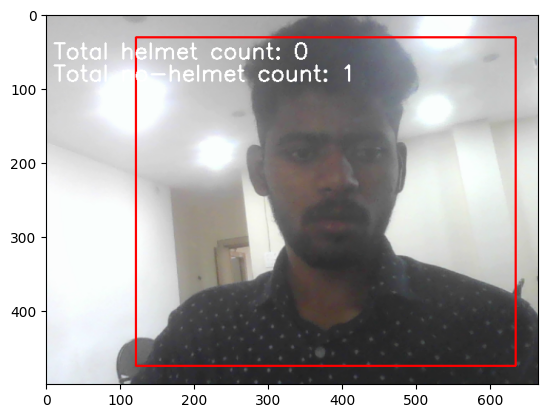

1/1 [==============================] - 0s 111ms/step


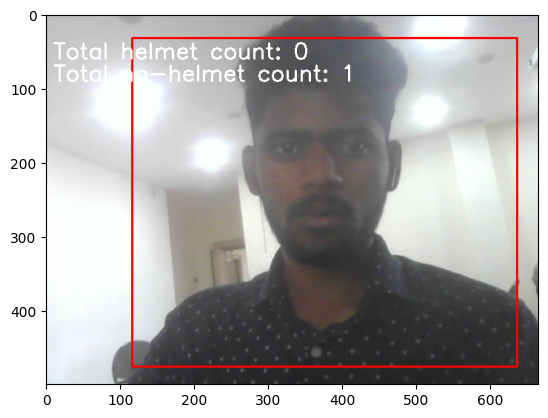

1/1 [==============================] - 0s 133ms/step


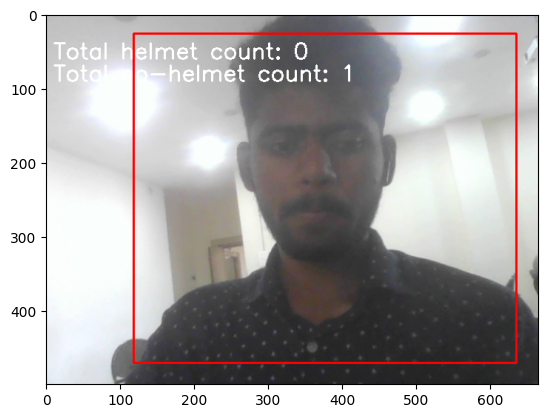

1/1 [==============================] - 0s 116ms/step


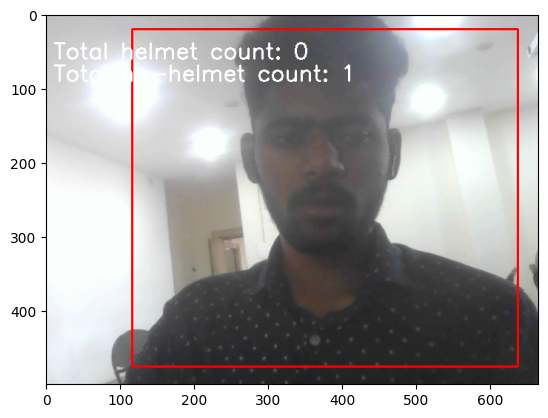

1/1 [==============================] - 0s 110ms/step


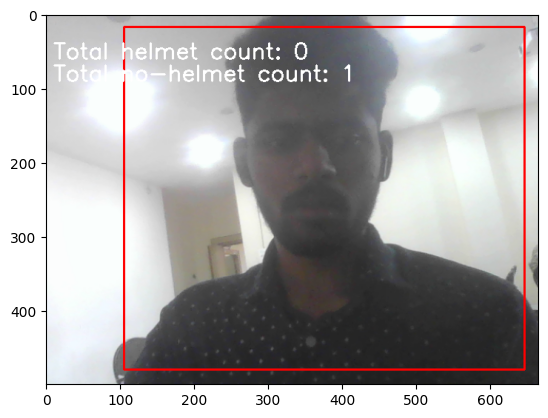

1/1 [==============================] - 0s 128ms/step


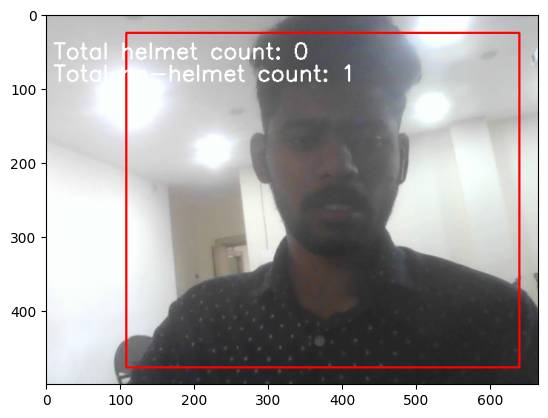

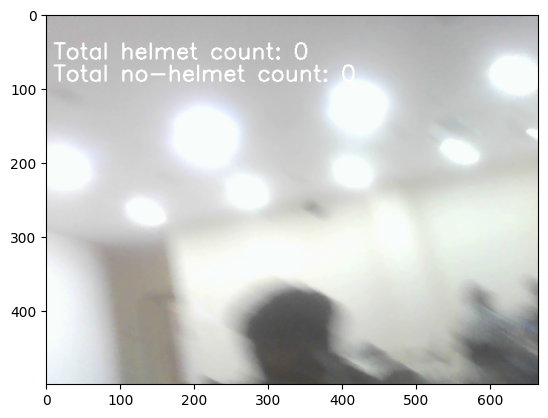

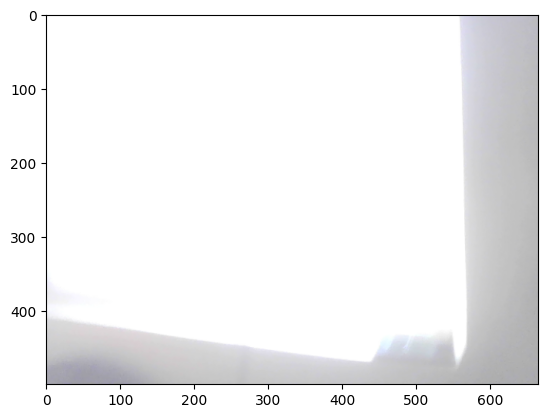

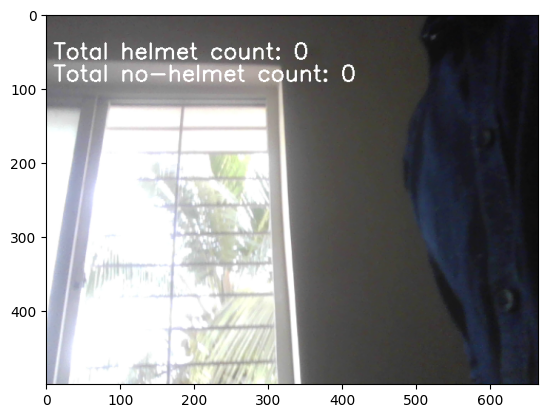

1/1 [==============================] - 0s 90ms/step


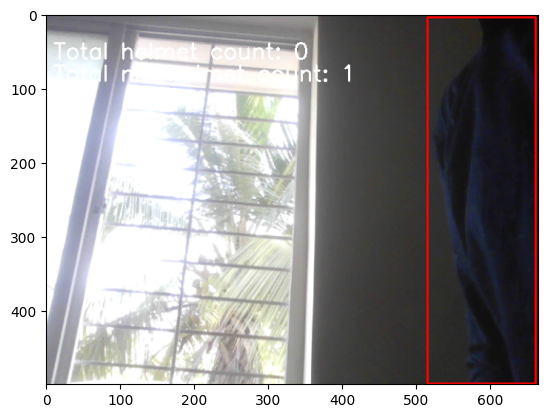

1/1 [==============================] - 0s 108ms/step


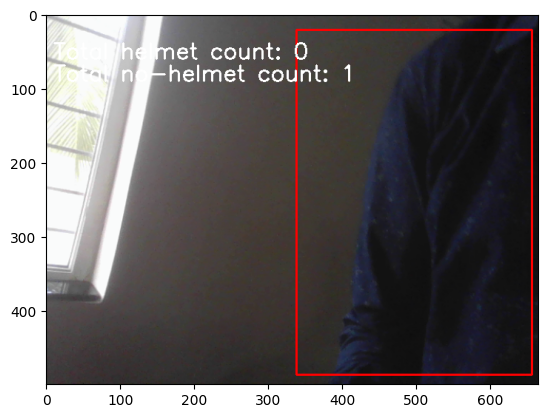

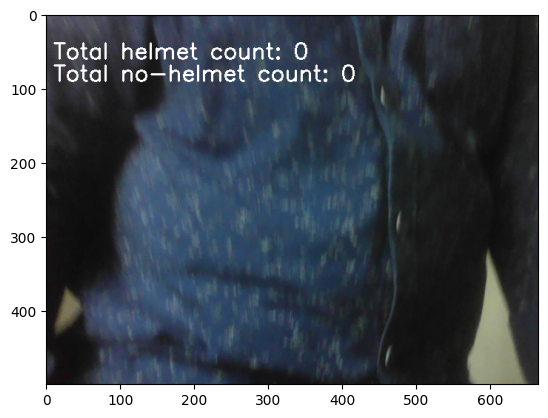

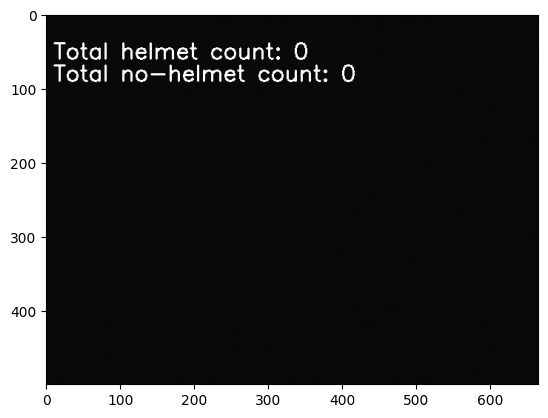

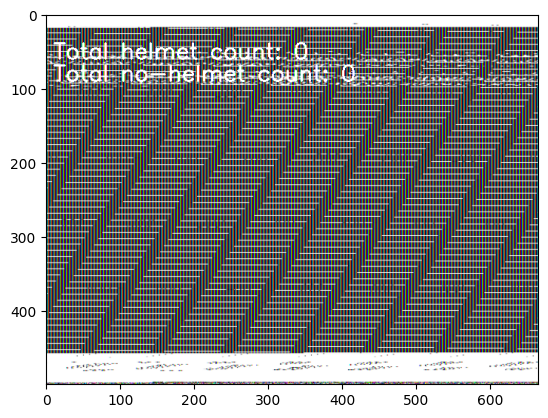

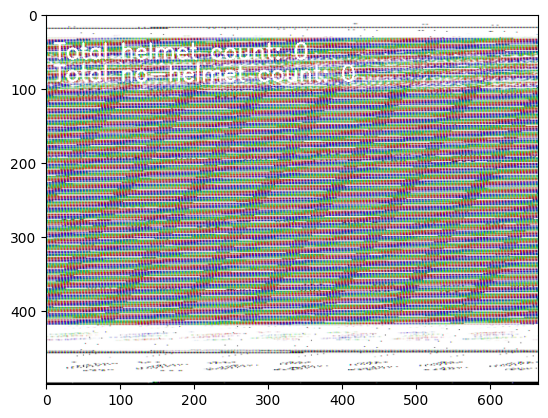

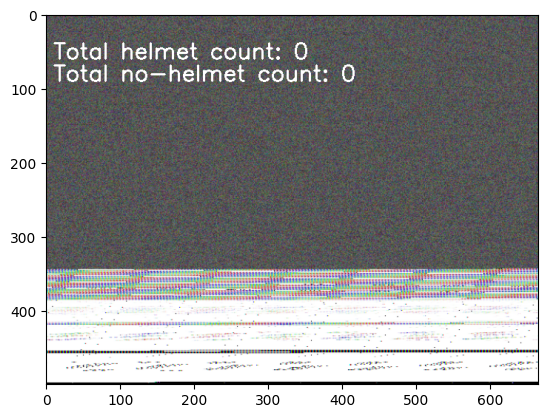

In [ ]:
import cv2
import numpy as np
import os
import imutils
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt

os.environ['TF_FORCE_GPU_ALLOW_GROWTH'] = 'true'

net = cv2.dnn.readNet("yolov3.weights", "yolov3.cfg")
net.setPreferableBackend(cv2.dnn.DNN_BACKEND_CUDA)
net.setPreferableTarget(cv2.dnn.DNN_TARGET_CUDA)

model = load_model(r"D:\ngit b tech\5th SENISTER\PROJECT SCHOOL\Helmet and Number Plate Detection and Recognition\yolo_model.h5")
print('model loaded!!!')

face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')

cap = cv2.VideoCapture(0)  # Use webcam, change to the appropriate index if you have multiple cameras
COLORS = [(0, 0, 255)]  # Red color only

fourcc = cv2.VideoWriter_fourcc(*"XVID")  # open-source MPEG-4 video codec
writer = cv2.VideoWriter('output.avi', fourcc, 5, (888, 500))

def helmet_or_nohelmet(helmet_roi):
    try:
        helmet_roi = cv2.resize(helmet_roi, (224, 224))
        helmet_roi = np.array(helmet_roi, dtype='float32')
        helmet_roi = helmet_roi.reshape(1, 224, 224, 3)
        helmet_roi = helmet_roi / 255.0
        return int(model.predict(helmet_roi)[0][0])
    except:
        pass

layer_names = net.getLayerNames()
output_layers = [layer_names[i - 1] for i in net.getUnconnectedOutLayers()]

while True:
    ret, img = cap.read()
    if not ret:
        break

    img = imutils.resize(img, height=500)
    height, width = img.shape[:2]

    blob = cv2.dnn.blobFromImage(img, 0.00392, (416, 416), (0, 0, 0), True, crop=False)  # prepares an image for input to a neural network.

    net.setInput(blob)
    outs = net.forward(output_layers)

    confidences = []
    boxes = []
    classIds = []

    total_helmet_count = 0  # Initialize total helmet count for the current frame
    total_no_helmet_count = 0  # Initialize total no-helmet count for the current frame

    for out in outs:
        for detection in out:
            scores = detection[5:]
            class_id = np.argmax(scores)
            confidence = scores[class_id]
            if confidence > 0.5:
                center_x = int(detection[0] * width)
                center_y = int(detection[1] * height)

                w = int(detection[2] * width)
                h = int(detection[3] * height)
                x = int(center_x - w / 2)
                y = int(center_y - h / 2)

                boxes.append([x, y, w, h])
                confidences.append(float(confidence))
                classIds.append(class_id)

    indexes = cv2.dnn.NMSBoxes(boxes, confidences, 0.5, 0.4)

    for i in range(len(boxes)):
        if i in indexes:
            x, y, w, h = boxes[i]

            # Extract the helmet region
            helmet_roi = img[max(0, y):max(0, y) + max(0, h) // 4, max(0, x):max(0, x) + max(0, w)]

            # Check if the detected object is a person (class_id = 0)
            if classIds[i] == 0:
                # Check if the person is wearing a helmet
                if helmet_or_nohelmet(helmet_roi) == 1:
                    # Draw a box around the person since they are wearing a helmet
                    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 255, 0), 2)

                    # Increment the total helmet count for the current frame
                    total_helmet_count += 1
                else:
                    # Draw a box around the person since they are not wearing a helmet
                    cv2.rectangle(img, (x, y), (x + w, y + h), (0, 0, 255), 2)

                    # Increment the total no-helmet count for the current frame
                    total_no_helmet_count += 1

    # Display the counts for the current frame
    cv2.putText(img, f'Total helmet count: {total_helmet_count}', (10, 60), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)
    cv2.putText(img, f'Total no-helmet count: {total_no_helmet_count}', (10, 90), cv2.FONT_HERSHEY_SIMPLEX, 1, (255, 255, 255), 2)

    writer.write(img)
    plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
    plt.show()

# Release resources
writer.release()
cap.release()
cv2.destroyAllWindows()
